In [ ]:
import geopandas
from geopandas import GeoDataFrame
from shapely.geometry import Point, mapping

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import pickle
from tqdm.notebook import tqdm

import os
import sys
this_dir = os.path.dirname(os.path.abspath(__file__))
root_dir = os.path.abspath(os.path.join(this_dir, '..'))
sys.path.insert(0, root_dir)

from utils.DB_connect import get_engine
from sqlalchemy import text

from rasterio.features import rasterize
from affine import Affine
from wordcloud import WordCloud
import folium

engine = get_engine()

In [3]:
korea = geopandas.read_file('data/gadm41_KOR_shp/gadm41_KOR_2.shp')

korea

,GID_2,GID_0,COUNTRY,GID_1,NAME_1,NL_NAME_1,NAME_2,VARNAME_2,NL_NAME_2,TYPE_2,ENGTYPE_2,CC_2,HASC_2,geometry
0,KOR.1.1_2,KOR,South Korea,KOR.1_1,Busan,부산광역시 | 釜山廣域市,Buk,NA,NA,Gu,District,NA,NA,"POLYGON ((129.02556 35.19174, 129.02258 35.188..."
1,KOR.1.2_2,KOR,South Korea,KOR.1_1,Busan,부산광역시 | 釜山廣域市,Busanjin,NA,NA,Gu,District,NA,NA,"POLYGON ((129.03317 35.1371, 129.0304 35.13714..."
2,KOR.1.3_2,KOR,South Korea,KOR.1_1,Busan,부산광역시 | 釜山廣域市,Dong,NA,NA,Gu,District,NA,NA,"POLYGON ((129.03649 35.11286, 129.03609 35.113..."
3,KOR.1.4_2,KOR,South Korea,KOR.1_1,Busan,부산광역시 | 釜山廣域市,Dongnae,NA,NA,Gu,District,NA,NA,"POLYGON ((129.11604 35.20114, 129.11532 35.199..."
4,KOR.1.5_2,KOR,South Korea,KOR.1_1,Busan,부산광역시 | 釜山廣域市,Gangseo,NA,NA,Gu,District,NA,NA,"MULTIPOLYGON (((128.77423 35.01478, 128.7758 3..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
224,KOR.17.1_2,KOR,South Korea,KOR.17_1,Ulsan,울산광역시 | 蔚山廣域市,Buk,NA,NA,Gu,District,NA,NA,"POLYGON ((129.41328 35.55469, 129.41184 35.553..."
225,KOR.17.2_2,KOR,South Korea,KOR.17_1,Ulsan,울산광역시 | 蔚山廣域市,Dong,NA,NA,Gu,District,NA,NA,"MULTIPOLYGON (((129.39983 35.46662, 129.4024 3..."
226,KOR.17.3_2,KOR,South Korea,KOR.17_1,Ulsan,울산광역시 | 蔚山廣域市,Jung,NA,NA,Gu,District,NA,NA,"POLYGON ((129.35153 35.55937, 129.35136 35.559..."
227,KOR.17.4_2,KOR,South Korea,KOR.17_1,Ulsan,울산광역시 | 蔚山廣域市,Nam,NA,NA,Gu,District,NA,NA,"POLYGON ((129.36645 35.5424, 129.36697 35.5415..."


<Axes: >

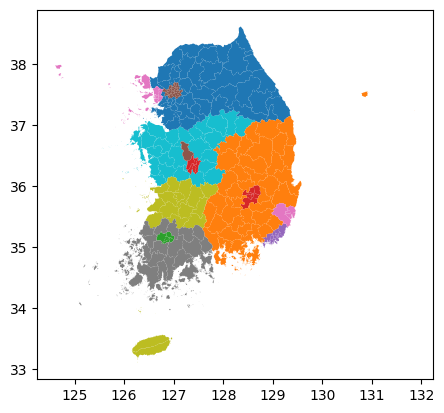

In [4]:
korea.plot('NL_NAME_1')

In [5]:
korea.crs

<Geographic 2D CRS: EPSG:4326>
Name: WGS 84
Axis Info [ellipsoidal]:
- Lat[north]: Geodetic latitude (degree)
- Lon[east]: Geodetic longitude (degree)
Area of Use:
- name: World.
- bounds: (-180.0, -90.0, 180.0, 90.0)
Datum: World Geodetic System 1984 ensemble
- Ellipsoid: WGS 84
- Prime Meridian: Greenwich

<Axes: >

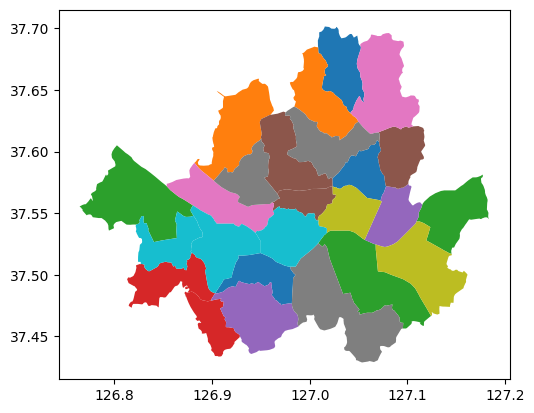

In [6]:
seoul = korea.loc[korea['NAME_1'] == 'Seoul']
seoul.plot('NAME_2')

In [7]:
with engine.connect() as conn:
    result = conn.execute(text(
        'SELECT `id`, `도서관명`, `위도`, `경도` ' \
        'FROM library_data ' \
        'WHERE `위도` IS NOT NULL AND `경도` IS NOT NULL'
    ))
    count = conn.execute(text(
        'SELECT count(*) ' \
        'FROM library_data ' \
        'WHERE `위도` IS NOT NULL AND `경도` IS NOT NULL'
    ))

print(count.all()[0][0])

result = result.all()
result[1:10]

3278


[(4, '해공도서관', 37.54394767, 127.1255384),
 (5, '용흥 작은도서관', 33.25145567, 126.4824083),
 (7, '강일도서관', 37.5650504, 127.1739063),
 (8, '암사도서관', 37.5528007, 127.1333457),
 (9, '천호도서관', 37.54052196, 127.1340837),
 (11, '둔촌도서관', 37.5317359, 127.1483674),
 (13, '정읍시립신태인도서관', 35.689748, 126.8899813),
 (16, '정읍기적의도서관', 35.58427178, 126.8606536),
 (19, '북면작은도서관', 35.6064496, 126.8895788)]

In [8]:
df_lib_dict = {
    'id': [],
    'name': [],
    'lat': [],
    'lon': [],
}
for id, name, lat, lon in result:
    df_lib_dict['id'].append(id)
    df_lib_dict['name'].append(name)
    df_lib_dict['lat'].append(lat)
    df_lib_dict['lon'].append(lon)

df_lib_points = pd.DataFrame(df_lib_dict).set_index('id')
df_lib_points

,name,lat,lon
id,,,
2,성내도서관,37.532846,127.133328
4,해공도서관,37.543948,127.125538
5,용흥 작은도서관,33.251456,126.482408
7,강일도서관,37.565050,127.173906
8,암사도서관,37.552801,127.133346
...,...,...,...
3513,순창군립도서관,35.373735,127.140740
3514,꿈꾸는아이들,35.188668,126.890503
3515,Book적북적작은도서관,35.171182,128.180148


In [9]:
df_lib_points['geometry'] = df_lib_points.apply(lambda row: Point(row.lon, row.lat), axis=1)
gdf_points = geopandas.GeoDataFrame(df_lib_points, geometry='geometry', crs=seoul.crs)

In [10]:
m = korea.explore(
    column="NAME_2",
    tooltip=True,
    style_kwds={'fillOpacity': 0.5},
    legend=False
)

gdf_points.explore(
    m=m,
    marker_type='circle',
    marker_kwds={
        'radius': 15,
        'color': 'red',
        'fill': True,
        'fill_opacity': 0.7
    },
    tooltip=True,
    popup=False
)

In [11]:
with engine.connect() as conn:
    in_seoul = conn.execute(text(
        'SELECT `id`, `도서관명`, `위도`, `경도` ' \
        'FROM library_data ' \
        'WHERE ' \
        '`위도` IS NOT NULL AND ' \
        '`경도` IS NOT NULL AND' \
        '`시도명` = "서울특별시"'
    ))
in_seoul = in_seoul.all()
in_seoul[:20]

[(2, '성내도서관', 37.53284628, 127.1333283),
 (4, '해공도서관', 37.54394767, 127.1255384),
 (7, '강일도서관', 37.5650504, 127.1739063),
 (8, '암사도서관', 37.5528007, 127.1333457),
 (9, '천호도서관', 37.54052196, 127.1340837),
 (11, '둔촌도서관', 37.5317359, 127.1483674),
 (34, '은천동작은도서관', 37.48530456, 126.942434),
 (36, '조원작은도서관', 37.48256328, 126.907773),
 (87, '수락작은도서관', 37.6729097, 127.0831565736),
 (88, '해솔작은도서관', 37.66297906, 127.0693664),
 (95, '메아리작은도서관', 37.65299, 127.057987),
 (103, '월계어린이도서관', 37.62358838, 127.0687815),
 (104, '꿈꾸는작은도서관', 37.61999132, 127.0628836),
 (108, '달내작은도서관', 37.63251005, 127.0507812),
 (156, '반포도서관', 37.50248861, 127.012535),
 (157, '은광교회도서관', 37.6126562, 126.92979),
 (163, '바다의 별 작은도서관', 37.61492896, 126.9262507),
 (165, '비전뜰 도서관', 37.62596114, 126.9208331),
 (166, '양재도서관', 37.473627, 127.0335724),
 (167, '다니엘 작은도서관', 37.62578369, 126.9275146)]

위 내용 바탕으로 함수 하나로 pipeline화 함.

In [12]:
def to_gdf(inp) -> GeoDataFrame:
    df_lib_dict = {
        'id': [],
        'name': [],
        'lat': [],
        'lon': [],
    }
    for id, name, lat, lon in inp:
        df_lib_dict['id'].append(id)
        df_lib_dict['name'].append(name)
        df_lib_dict['lat'].append(lat)
        df_lib_dict['lon'].append(lon)

    df_lib_points = pd.DataFrame(df_lib_dict).set_index('id')
    df_lib_points['geometry'] = df_lib_points.apply(lambda row: Point(row.lon, row.lat), axis=1)
    gdf_points = geopandas.GeoDataFrame(df_lib_points, geometry='geometry', crs=seoul.crs)

    return gdf_points

/tmp/ipykernel_648443/2360458528.py:18: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax.legend()


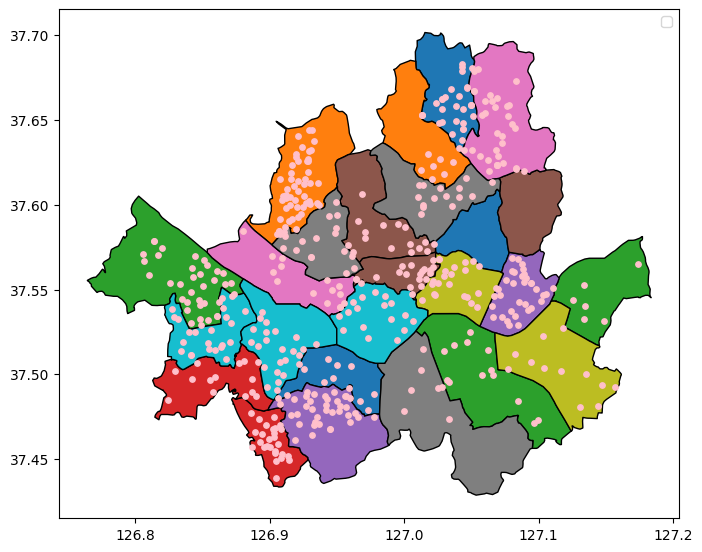

In [ ]:
gdf_seoul_points = to_gdf(in_seoul)

ax = seoul.plot(
    column='NAME_2',
    figsize=(8, 8),
    edgecolor='black',
    legend=True
)

gdf_seoul_points.plot(
    ax=ax,
    marker='o',
    color='pink',
    markersize=15,
)

ax.legend()

plt.show()

In [22]:
def get_kw(id: int):
    with open('./data/tfidf_score.pkl', 'rb') as f:
        tfidf_scores = pickle.load(f)
    
    if res := tfidf_scores.get(id):
        return {word: score for word, score in res}
    else:
        return {}

gdf_points['kw'] = gdf_points.index.map(get_kw)
gdf_points

,name,lat,lon,geometry,kw
id,,,,,
2,성내도서관,37.532846,127.133328,POINT (127.13333 37.53285),"{'강동': 1.8325814637483102, '이용': 1.83258146374..."
4,해공도서관,37.543948,127.125538,POINT (127.12554 37.54395),"{'여기': 1.8325814637483102, '서울시': 1.8325814637..."
5,용흥 작은도서관,33.251456,126.482408,POINT (126.48241 33.25146),"{'재개발': 1.8325814637483102, '세대': 1.8325814637..."
7,강일도서관,37.565050,127.173906,POINT (127.17391 37.56505),"{'얼굴': 2.7488721956224653, '전쟁': 2.74887219562..."
8,암사도서관,37.552801,127.133346,POINT (127.13335 37.5528),"{'서비스': 2.7488721956224653, '열람': 1.8325814637..."
...,...,...,...,...,...
3513,순창군립도서관,35.373735,127.140740,POINT (127.14074 35.37373),"{'아이': 1.0216512475319814, '제일': 0.91629073187..."
3514,꿈꾸는아이들,35.188668,126.890503,POINT (126.8905 35.18867),"{'환경': 3.6651629274966204, '행사': 1.83258146374..."
3515,Book적북적작은도서관,35.171182,128.180148,POINT (128.18015 35.17118),"{'그림책': 3.6651629274966204, '울산': 1.8325814637..."


  0%|          | 0/23 [00:00<?, ?it/s]


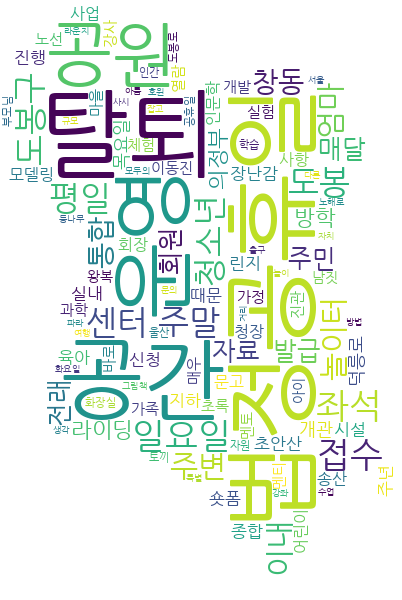
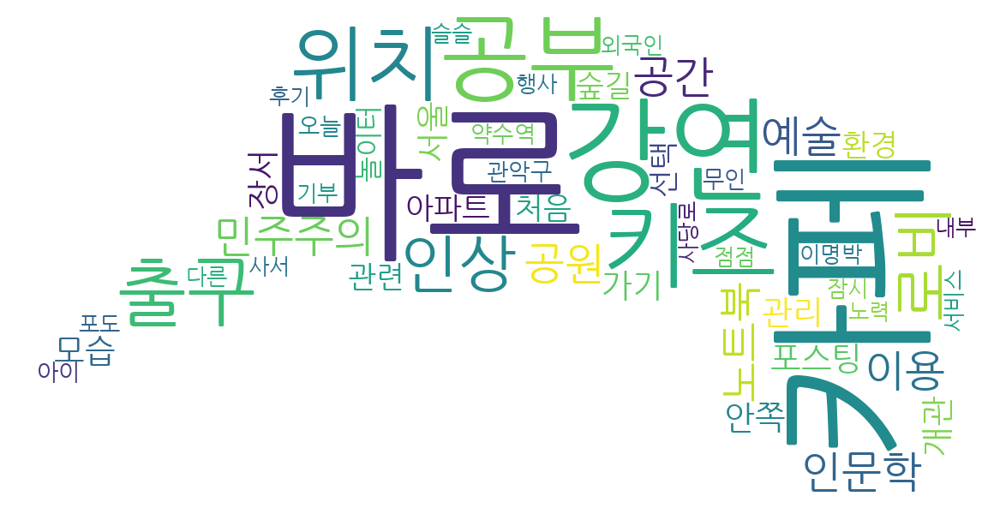
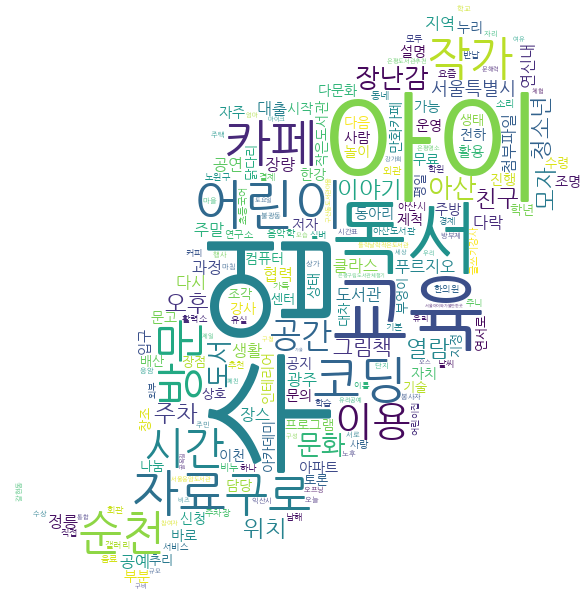
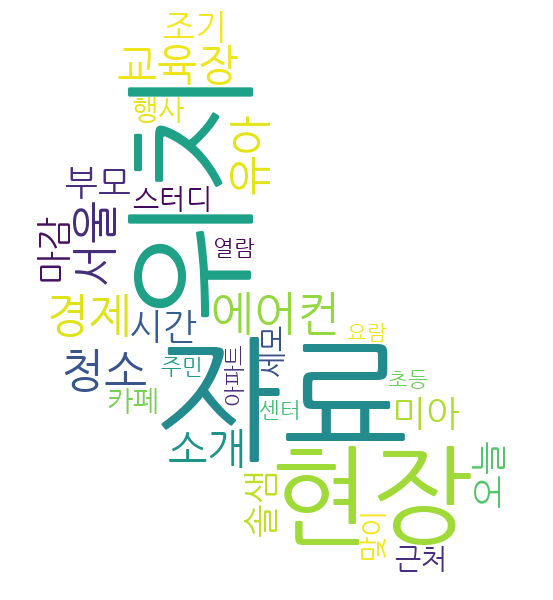
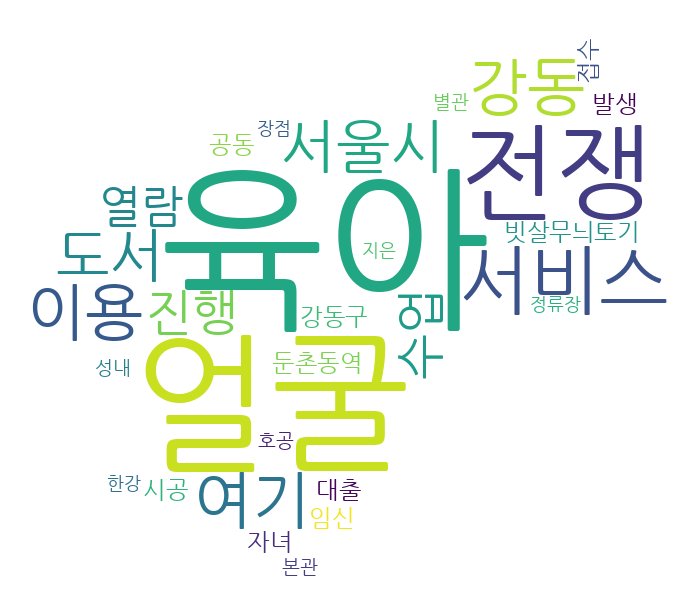
...
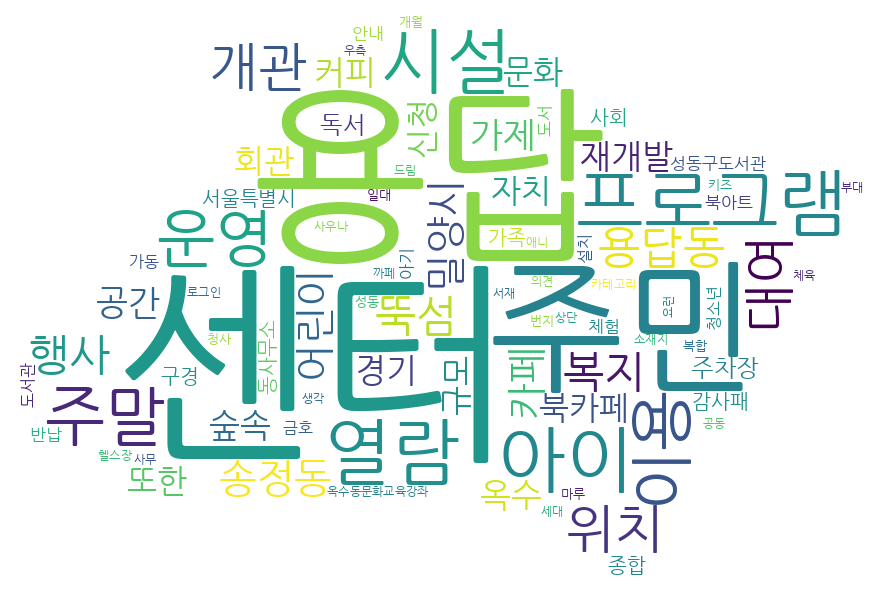
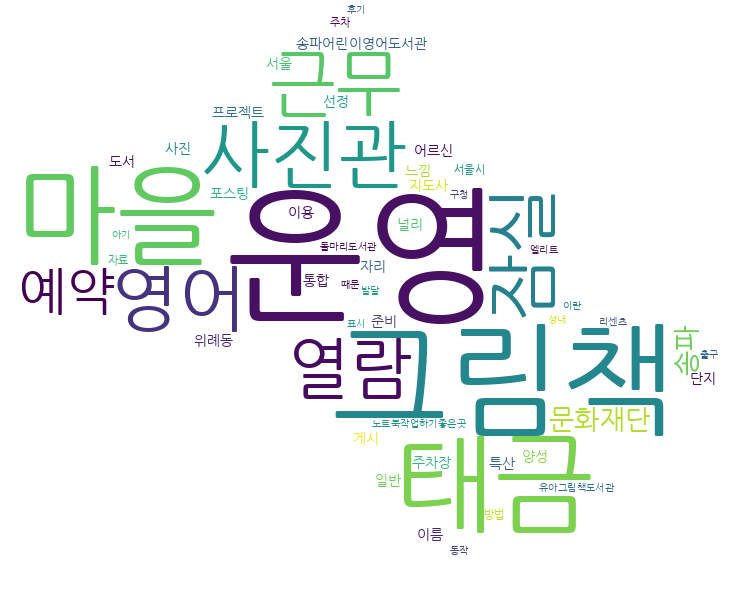
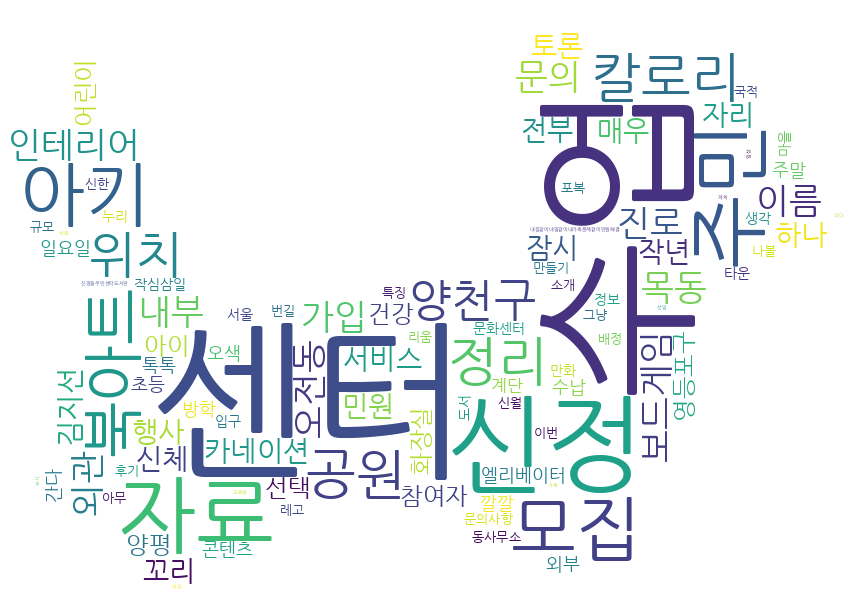
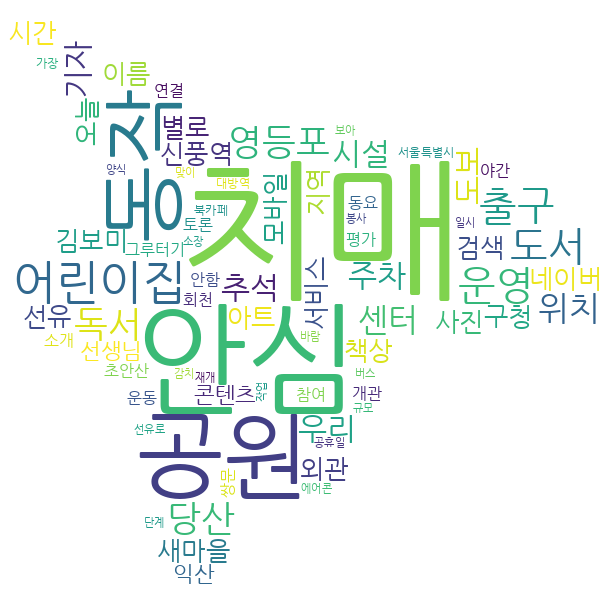
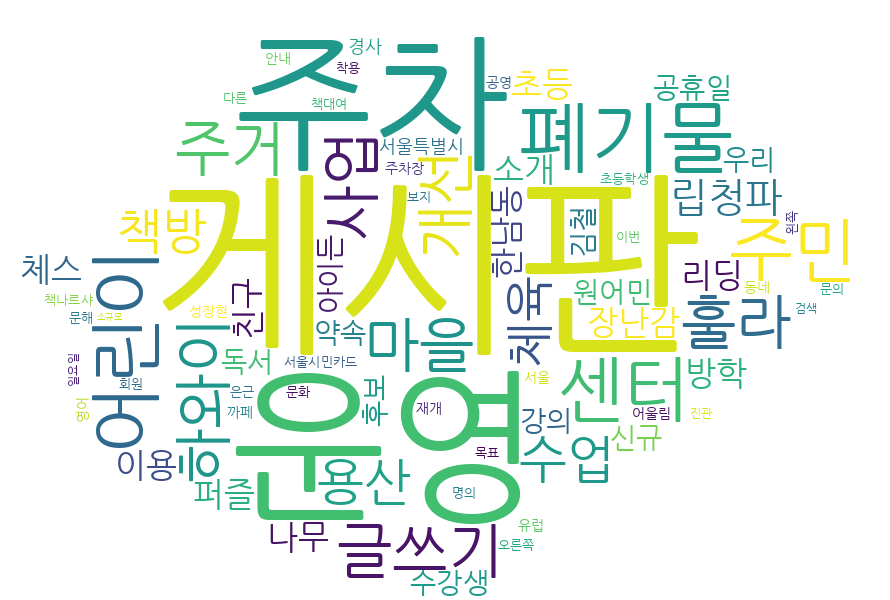

In [62]:
font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'\

# 수동 제거 리스트트
kill_list = {
    'Dobong': [],
    'Dongjak': [],
    'Eunpyeong': ['은평', '은평구'],
    'Gangbuk': ['강북구'],
    'Gangdong': ['얼굴굴'],
    'Gangnam': ['강남구'],
    'Gangseo': [],
    'Geumcheon': [],
    'Guro': ['구로'],
    'Gwanak': ['관악구'],
    'Gwangjin': ['중곡'],
    'Jongno': ['종로', '종로구'],
    'Jung': [],
    'Mapo': ['마포', '마포구'],
    'Nowon': [],
    'Seocho': ['서초'],
    'Seodaemun': [],
    'Seongbuk': [],
    'Seongdong': ['성동구'],
    'Songpa': ['송파구'],
    'Yangcheon': [],
    'Yeongdeungpo': ['영등포구', '영등포동'],
    'Yongsan': ['용산구'],
}

# 공간상 JOIN
pts_with_dist = geopandas.sjoin(
    gdf_points,
    seoul[['NAME_2','geometry']],
    how='left',
    predicate='within'
)
agg = {}
for district, group in pts_with_dist.groupby('NAME_2'):
    freq = {}
    for kw in group['kw']:
        for w, s in kw.items():
            freq[w] = freq.get(w, 0.0) + s
    agg[district] = freq

# 수동 제거 리스트
for district, kl in kill_list.items():
    [agg[district].pop(word, None) for word in kl]

m = seoul.explore(
    column="NAME_2",
    tooltip=True,
    style_kwds={'fillOpacity': 0.2},
    tiles="cartodbpositron",
    zoom_start=10,
    legend=False
)

gdf_points.explore(
    m=m,
    marker_type='circle',
    marker_kwds={
        'radius': 15,
        'color': 'red',
        'fill': True,
        'fill_opacity': 0.7
    },
    tooltip=True,
    popup=False
)


for district, freqs in tqdm(agg.items()):
    # get polygon & bounds
    poly = seoul.loc[seoul['NAME_2']==district, 'geometry'].union_all()
    minx, miny, maxx, maxy = poly.bounds

    # choose resolution & transform
    px_h = 600
    aspect = (maxx-minx)/(maxy-miny)
    px_w = int(px_h * aspect)
    transform = Affine((maxx-minx)/px_w, 0, minx,
                       0, -(maxy-miny)/px_h, maxy)

    # rasterize mask
    mask = rasterize(
        [(mapping(poly), 255)],
        out_shape=(px_h, px_w),
        transform=transform,
        fill=0,
        dtype=np.uint8
    )
    mask = 255 - mask      # invert: inside → 255
    # mask = mask[::-1, :]   # flip vertically

    # generate RGBA wordcloud
    wc = WordCloud(
        mask=mask,
        background_color=None,
        mode="RGBA",
        font_path=font_path, 
    ).generate_from_frequencies(freqs)
    img_arr = wc.to_array()

    # overlay on map
    folium.raster_layers.ImageOverlay(
        image=img_arr,
        bounds=[[miny, minx], [maxy, maxx]],
        opacity=0.6,
        name=district,
        interactive=True,
        cross_origin=False,
        zindex=2
    ).add_to(m)

m.save("./data/seoul_district_wordclouds.html")
m

In [55]:
korea_shido = geopandas.read_file('data/gadm41_KOR_shp/gadm41_KOR_1.shp')
korea_shido

,GID_1,GID_0,COUNTRY,NAME_1,VARNAME_1,NL_NAME_1,TYPE_1,ENGTYPE_1,CC_1,HASC_1,ISO_1,geometry
0,KOR.1_1,KOR,South Korea,Busan,Pusan|Busan Gwang'yeogsi|Pusan-g,부산광역시 | 釜山廣域市,Gwangyeoksi,Metropolitan City,NA,KR.PU,KR-26,"MULTIPOLYGON (((128.99193 34.9811, 128.99192 3..."
1,KOR.2_1,KOR,South Korea,Chungcheongbuk-do,Chungchongbuk-Do|Chungcheongbugd,충청북도 | 忠淸北道,Do,Province,NA,KR.GB,KR-43,"POLYGON ((127.60892 36.11856, 127.60553 36.118..."
2,KOR.3_1,KOR,South Korea,Chungcheongnam-do,Chungchongnam-Do|Ch'ungch'ong-na,충청남도 | 忠淸南道,Do,Province,NA,KR.GN,KR-44,"MULTIPOLYGON (((127.53324 36.03418, 127.53533 ..."
3,KOR.4_1,KOR,South Korea,Daegu,Taegu|Daegu Gwang'yeogsi|Taegu-g,대구광역시 | 大邱廣域市,Gwangyeoksi,Metropolitan City,NA,KR.TG,KR-27,"POLYGON ((128.45745 35.63956, 128.45743 35.639..."
4,KOR.5_1,KOR,South Korea,Daejeon,Daejeon Gwang'yeogsi|Taejŏn-gwan,대전광역시(大田廣域市,Gwangyeoksi,Metropolitan City,NA,KR.TJ,KR-30,"POLYGON ((127.41526 36.20904, 127.41488 36.209..."
5,KOR.6_1,KOR,South Korea,Gangwon-do,Kang-Won-Do|Gang'weondo|Kangwon-,강원도 | 江原道,Do,Province,NA,KR.KW,KR-42,"MULTIPOLYGON (((129.08501 37.09585, 129.08405 ..."
6,KOR.7_1,KOR,South Korea,Gwangju,Kwangju|Kwangju-gwangyoksi,광주광역시 | 光州廣域市,Gwangyeoksi,Metropolitan City,NA,KR.KJ,KR-29,"POLYGON ((126.89908 35.08119, 126.89762 35.081..."
7,KOR.8_1,KOR,South Korea,Gyeonggi-do,Kyonggi-do|Keiki-do|Kyunggi,경기도 | 京畿道,Do,Province,NA,KR.KG,KR-41,"MULTIPOLYGON (((127.06773 36.94224, 127.06769 ..."
8,KOR.9_1,KOR,South Korea,Gyeongsangbuk-do,Kyongsangbuk-Do|Gyeongsangbugdo|,경상북도 | 慶尙北道,Do,Province,NA,KR.KB,KR-47,"MULTIPOLYGON (((128.35719 35.6822, 128.35797 3..."
9,KOR.10_1,KOR,South Korea,Gyeongsangnam-do,Kyongsangnam-Do|Kyongsang-namdo|,경상남도 | 慶尙南道,Do,Province,NA,KR.KN,KR-48,"MULTIPOLYGON (((128.57901 34.64753, 128.579 34..."


  0%|          | 0/17 [00:00<?, ?it/s]


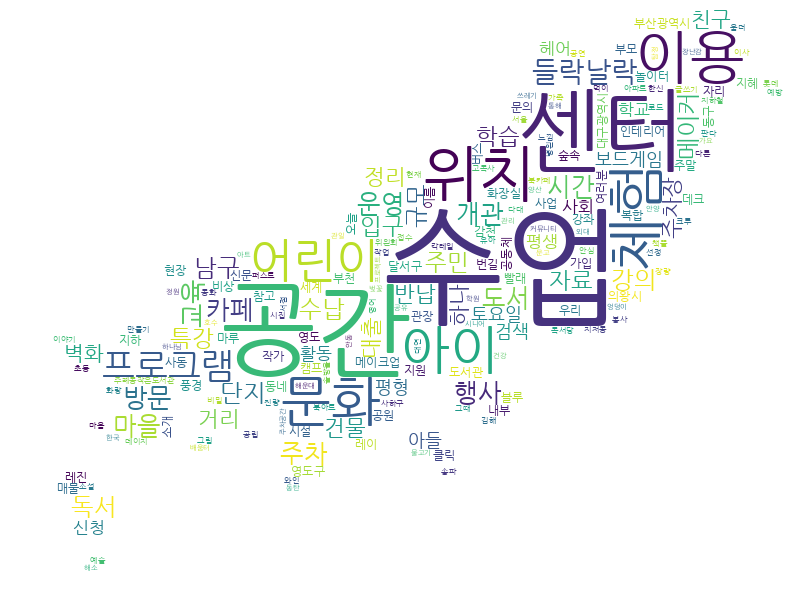
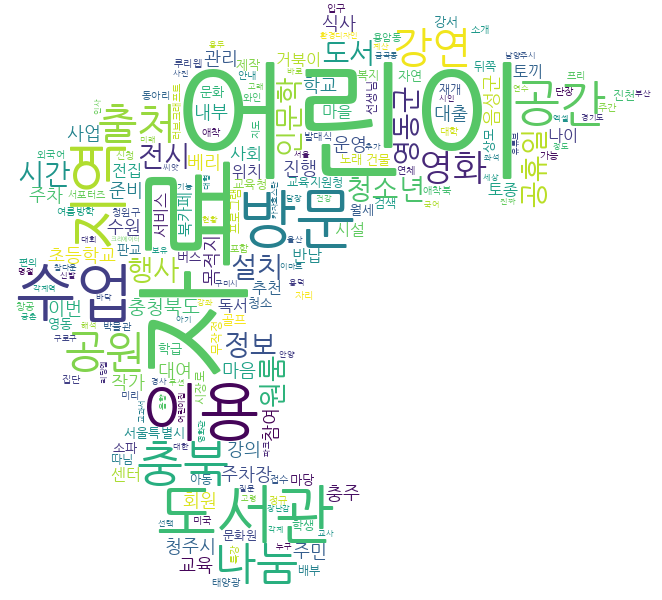
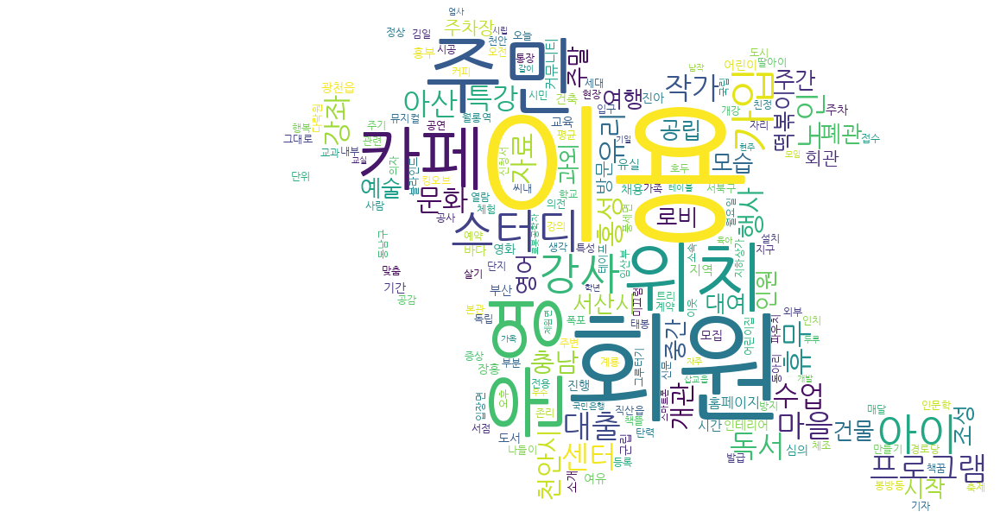
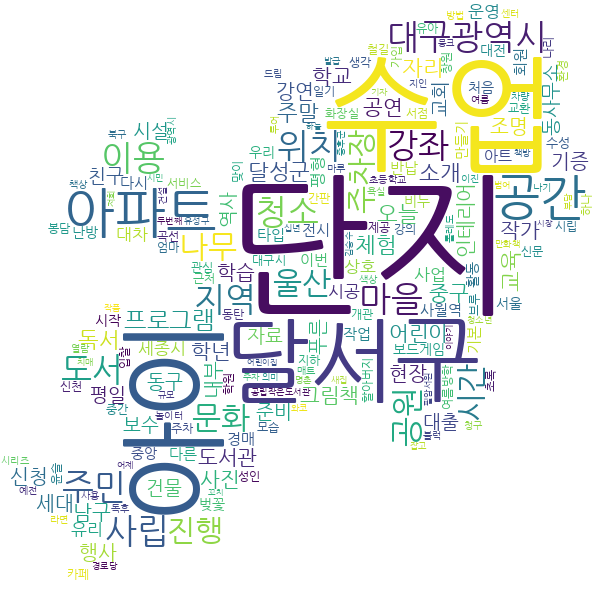
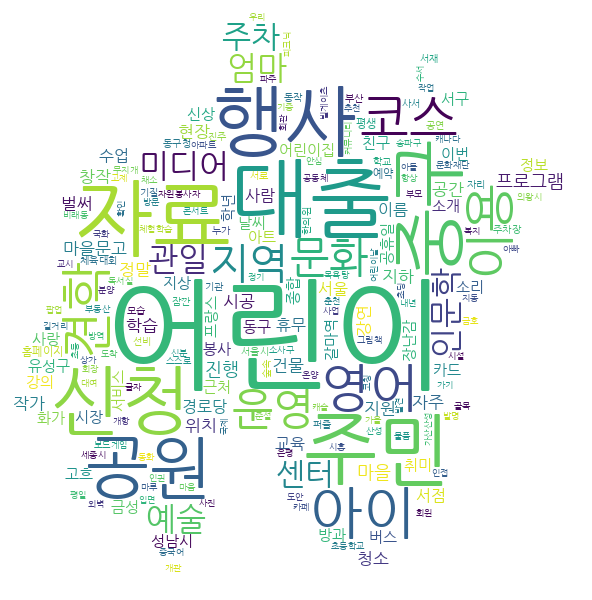
...
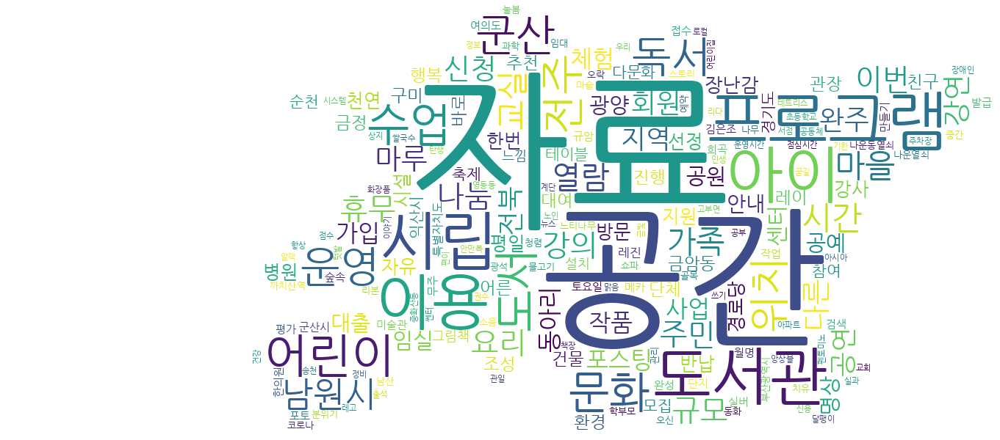
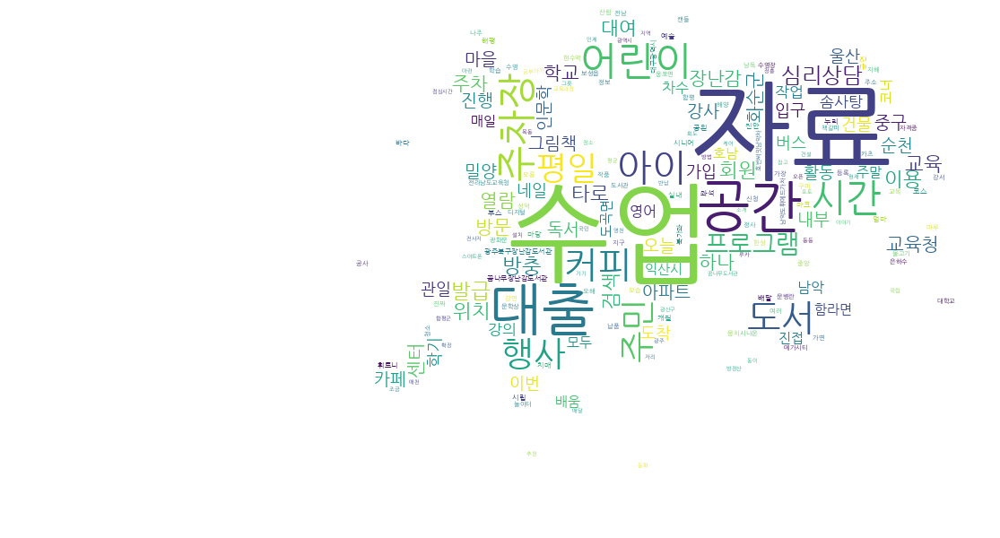
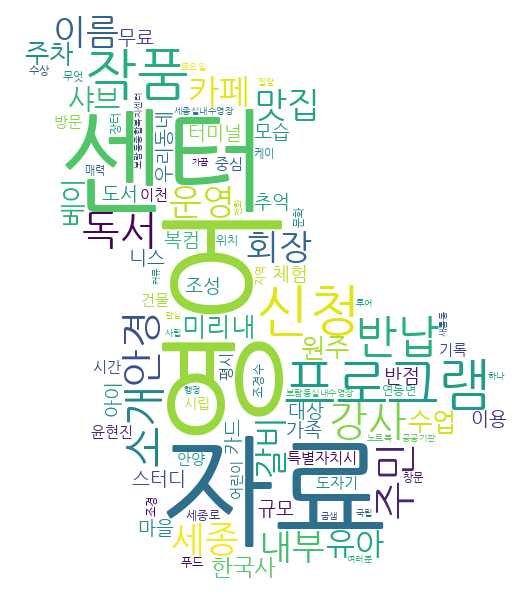
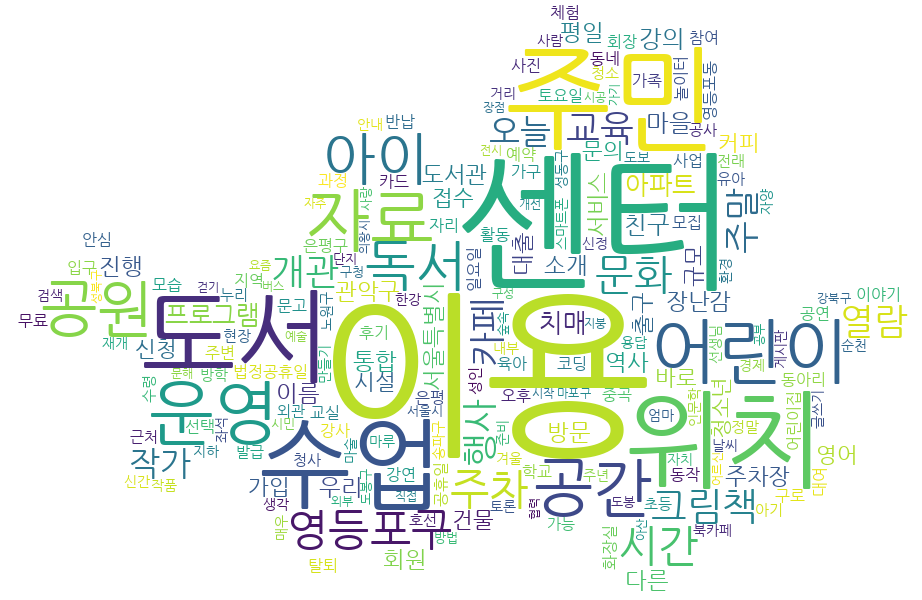
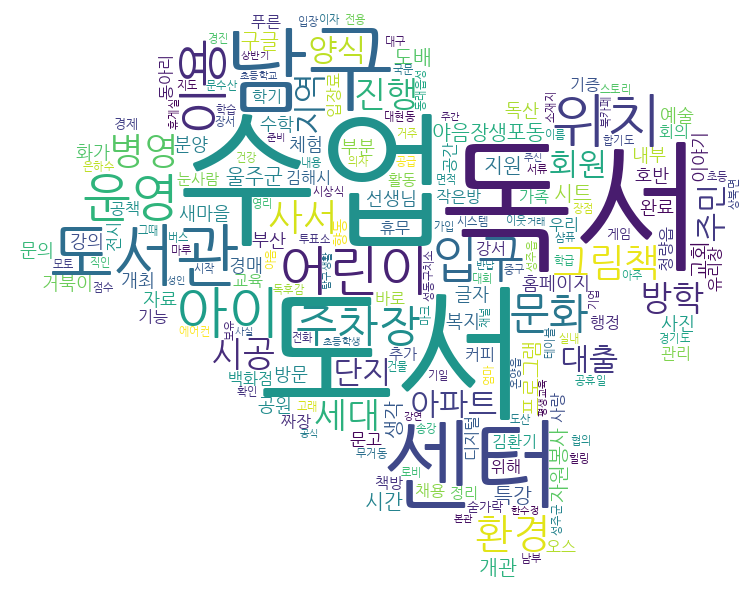

In [59]:
font_path = '/usr/share/fonts/truetype/nanum/NanumGothic.ttf'

# 수동 제거 키워드
kill_list = {
    'Busan': ['부산'],
    'Chungcheongbuk-do': [],
    'Chungcheongnam-do': [],
    'Daegu': ['대구'],
    'Daejeon': ['대전', '대전광역시'],
    'Gangwon-do': ['강원도'],
    'Gwangju': ['대구광역시', '광주', '달서구', '광역시'],
    'Gyeonggi-do': [],
    'Gyeongsangbuk-do': ['경상북도'],
    'Gyeongsangnam-do': ['경남'],
    'Incheon': ['인천'],
    'Jeju': ['제주도'],
    'Jeollabuk-do': ['전라북도'],
    'Jeollanam-do': ['전라남도'],
    'Sejong': ['세종시'],
    'Seoul': ['서울'],
    'Ulsan': ['울산', '광역시'],
}

# 공간 상 JOIN
pts_with_dist = geopandas.sjoin(
    gdf_points,
    korea_shido[['NAME_1','geometry']],
    how='left',
    predicate='within'
)
agg = {}
for district, group in pts_with_dist.groupby('NAME_1'):
    freq = {}
    for kw in group['kw']:
        for w, s in kw.items():
            freq[w] = freq.get(w, 0.0) + s
    agg[district] = freq

# 수동 제거 리스트
for district, kl in kill_list.items():
    [agg[district].pop(word, None) for word in kl]

m = korea_shido.explore(
    column="NAME_1",
    tooltip=True,
    style_kwds={'fillOpacity': 0.2},
    tiles="cartodbpositron",
    zoom_start=10,
    legend=False
)

# gdf_points.explore(
#     m=m,
#     marker_type='circle',
#     marker_kwds={
#         'radius': 15,
#         'color': 'red',
#         'fill': True,
#         'fill_opacity': 0.7
#     },
#     tooltip=True,
#     popup=False
# )

# 각 지역별 워드클라우드 제작작
for district, freqs in tqdm(agg.items()):
    # get polygon & bounds
    poly = korea_shido.loc[korea_shido['NAME_1']==district, 'geometry'].union_all()
    minx, miny, maxx, maxy = poly.bounds

    # choose resolution & transform
    px_h = 600
    aspect = (maxx-minx)/(maxy-miny)
    px_w = int(px_h * aspect)
    transform = Affine((maxx-minx)/px_w, 0, minx,
                       0, -(maxy-miny)/px_h, maxy)

    # rasterize mask
    mask = rasterize(
        [(mapping(poly), 255)],
        out_shape=(px_h, px_w),
        transform=transform,
        fill=0,
        dtype=np.uint8
    )
    mask = 255 - mask      # invert: inside → 255
    # mask = mask[::-1, :]   # flip vertically

    # generate RGBA wordcloud
    wc = WordCloud(
        mask=mask,
        background_color=None,
        mode="RGBA",
        font_path=font_path, 
    ).generate_from_frequencies(freqs)
    img_arr = wc.to_array()

    # overlay on map
    folium.raster_layers.ImageOverlay(
        image=img_arr,
        bounds=[[miny, minx], [maxy, maxx]],
        opacity=0.6,
        name=district,
        interactive=True,
        cross_origin=False,
        zindex=2
    ).add_to(m)

m.save("./data/korea_province_wordclouds.html")
m